<a href="https://colab.research.google.com/github/Bashinim/Parking-Lot-Detection/blob/main/Detectron2/COWC_Instance_Segmentation_Detectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Instance Segmentation with COWC dataset. The annotations are in COCO format


In [1]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [2]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 703.8MB 26kB/s 
     |████████████████████████████████| 6.6MB 56.3MB/s 
ERROR: torchtext 0.10.0 has requirement torch==1.9.0, but you'll have torch 1.5.0+cu101 which is incompatible.
  Found existing installation: torch 1.9.0+cu102
    Uninstalling torch-1.9.0+cu102:
      Successfully uninstalled torch-1.9.0+cu102
  Found existing installation: torchvision 0.10.0+cu102
    Uninstalling torchvision-0.10.0+cu102:
      Successfully uninstalled torchvision-0.10.0+cu102
     |████████████████████████████████| 276kB 14.6MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44091 sha256=48cecf70282a64f51da27798b59d80a2b6ba16c36c7a671a40764b7322d0e9e8
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAM

In [3]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.8)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
#import torch
#assert torch.__version__.startswith("1.8")   # need to manually install torch 1.8 if Colab changes its default version
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
     |████████████████████████████████| 6.2MB 637kB/s 
     |████████████████████████████████| 51kB 7.9MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20210624-cp37-none-any.whl size=60611 sha256=8dd94638b653f3ac8881cb0fcdf89911578c8c39f8ee644615a6a3a33bdc732c
  Stored in directory: /root/.cache/pip/wheels/6d/3d/8b/911fda7dc70c40197710f00c0e0b6d0d11c4d0bfb620567894
Successfully built fvcore


## Get data

In [4]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

Importing data

In [5]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/drive/MyDrive/Cowc for detectrone2 test/Train_annotations.json", "/content/drive/MyDrive/Cowc for detectrone2 test/train")
#register_coco_instances("my_dataset_valid", {}, "/content/drive/MyDrive/COWC in COCO format/valid/annotations_valid.json", "/content/drive/MyDrive/COWC in COCO format/valid")
register_coco_instances("my_dataset_test", {}, "/content/drive/MyDrive/Cowc for detectrone2 test/Test_annotations.json", "/content/drive/MyDrive/Cowc for detectrone2 test/test")

## Register data-set

In order to use a dataset with Detectron2 we need to register it. For more information check out the official documentation.

WARNING [06/25 13:52:14 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/25 13:52:14 d2.data.datasets.coco]: Loaded 71 images in COCO format from /content/drive/MyDrive/Cowc for detectrone2 test/Train_annotations.json


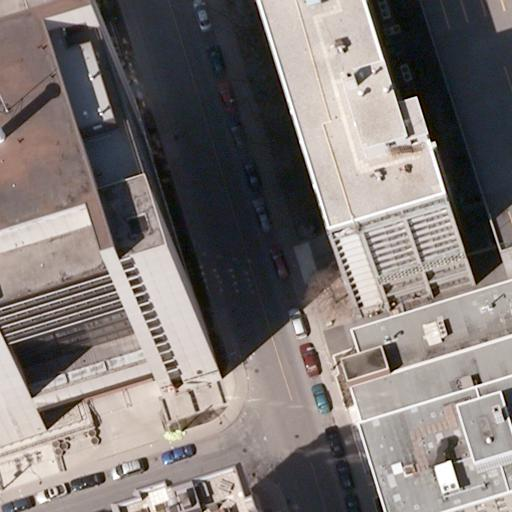

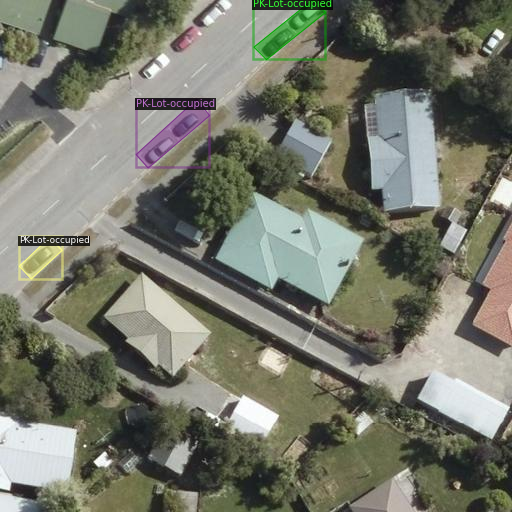

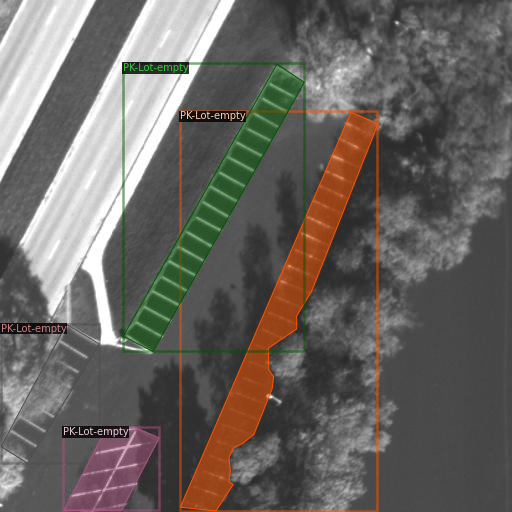

In [6]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

## Train model

Now, let's fine-tune a pretrained FasterRCNN instance segmentation model on the microcontroller data-set.

In [7]:
%%javascript
function ClickConnect(){
console.log("Working");
document.querySelector("colab-toolbar-button#connect").click()
}setInterval(ClickConnect,60000)

<IPython.core.display.Javascript object>

In [8]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0025
cfg.SOLVER.MAX_ITER = 700
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()


[06/25 13:52:38 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:18, 9.36MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (5, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (5,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (16, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (16,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to

[06/25 13:52:59 d2.engine.train_loop]: Starting training from iteration 0
[06/25 13:53:09 d2.utils.events]:  eta: 0:05:00  iter: 19  total_loss: 2.706  loss_cls: 1.442  loss_box_reg: 0.135  loss_mask: 0.693  loss_rpn_cls: 0.335  loss_rpn_loc: 0.055  time: 0.4539  data_time: 0.3636  lr: 0.000050  max_mem: 2174M
[06/25 13:53:16 d2.utils.events]:  eta: 0:04:33  iter: 39  total_loss: 1.715  loss_cls: 0.705  loss_box_reg: 0.153  loss_mask: 0.679  loss_rpn_cls: 0.138  loss_rpn_loc: 0.028  time: 0.3855  data_time: 0.1971  lr: 0.000100  max_mem: 2174M
[06/25 13:53:19 d2.utils.events]:  eta: 0:03:53  iter: 59  total_loss: 1.453  loss_cls: 0.370  loss_box_reg: 0.263  loss_mask: 0.654  loss_rpn_cls: 0.137  loss_rpn_loc: 0.044  time: 0.3086  data_time: 0.0055  lr: 0.000150  max_mem: 2450M
[06/25 13:53:22 d2.utils.events]:  eta: 0:01:48  iter: 79  total_loss: 1.425  loss_cls: 0.372  loss_box_reg: 0.294  loss_mask: 0.620  loss_rpn_cls: 0.095  loss_rpn_loc: 0.029  time: 0.2707  data_time: 0.0059  lr:

In [9]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Use model for inference

Now, we can perform inference on our validation set by creating a predictor object.

In [10]:
# DatasetCatalog.clear()
# MetadataCatalog.clear()

In [11]:
# cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
# cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 
# cfg.DATASETS.TEST = ("my_dataset_test", )
# predictor = DefaultPredictor(cfg)

In [12]:
#test evaluation
test_metadata = MetadataCatalog.get("my_dataset_test")
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.DATASETS.TEST = ("my_dataset_test", )
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [06/25 13:55:20 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/25 13:55:20 d2.data.datasets.coco]: Loaded 31 images in COCO format from /content/drive/MyDrive/Cowc for detectrone2 test/Test_annotations.json
[06/25 13:55:20 d2.data.build]: Distribution of instances among all 2 categories:
|   category   | #instances   |   category    | #instances   |
|:------------:|:-------------|:-------------:|:-------------|
| PK-Lot-empty | 77           | PK-Lot-occu.. | 62           |
|              |              |               |              |
|    total     | 139          |               |              |
[06/25 13:55:20 d2.data.common]: Serializing 31 elements to byte tensors and concatenating them all ...
[06/25 13:55:20 d2.data.common]: Serialized dataset takes 0.03 MiB
[06/25 13:55:20 d2.evaluation.evaluator]: Start inference on 31 images
[06/25 13:55:25 d2.evaluation.evaluator]: Inference done 11/31. 0.0374 s / 

OrderedDict([('bbox',
              {'AP': 32.80468558604884,
               'AP-PK-Lot-empty': 39.25227497257893,
               'AP-PK-Lot-occupied': 26.357096199518747,
               'AP50': 60.13649825319417,
               'AP75': 33.60637326481263,
               'APl': 60.6836795679116,
               'APm': 32.237944444664286,
               'APs': 26.003472764375644}),
             ('segm',
              {'AP': 30.27654764705646,
               'AP-PK-Lot-empty': 37.32179156277965,
               'AP-PK-Lot-occupied': 23.23130373133327,
               'AP50': 57.533076517165846,
               'AP75': 28.729416203440923,
               'APl': 70.32120959348681,
               'APm': 30.68714976176526,
               'APs': 17.515055123795996})])

WARNING [06/25 13:55:30 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/25 13:55:30 d2.data.datasets.coco]: Loaded 31 images in COCO format from /content/drive/MyDrive/Cowc for detectrone2 test/Test_annotations.json


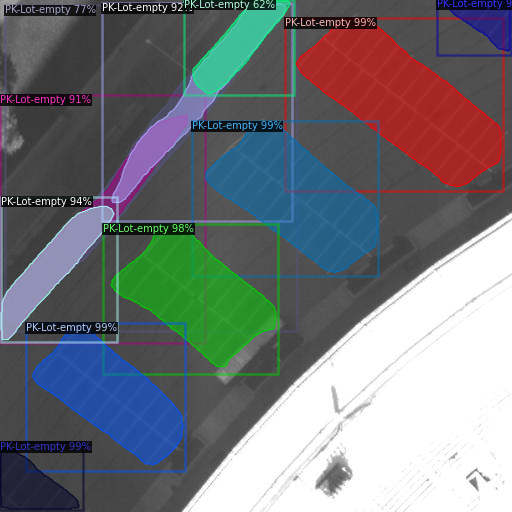

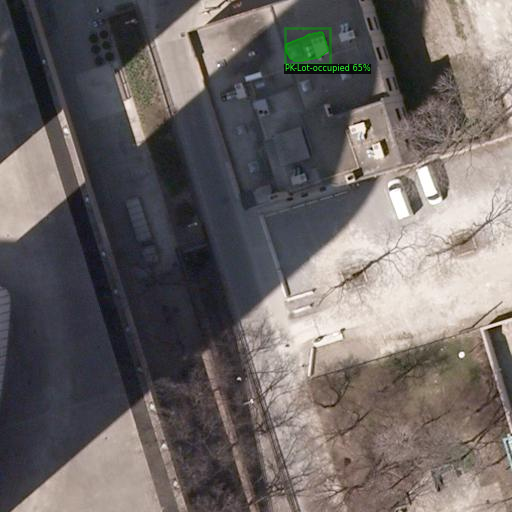

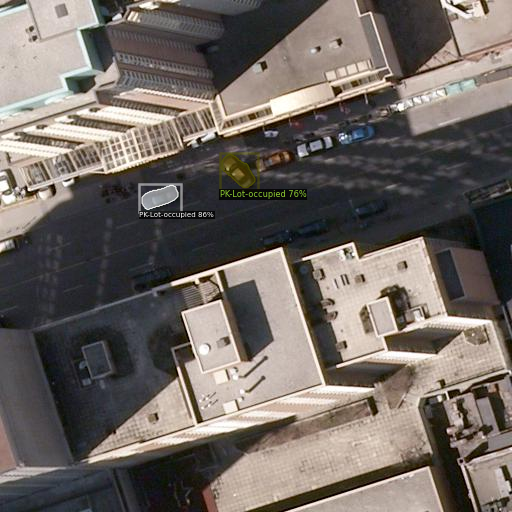

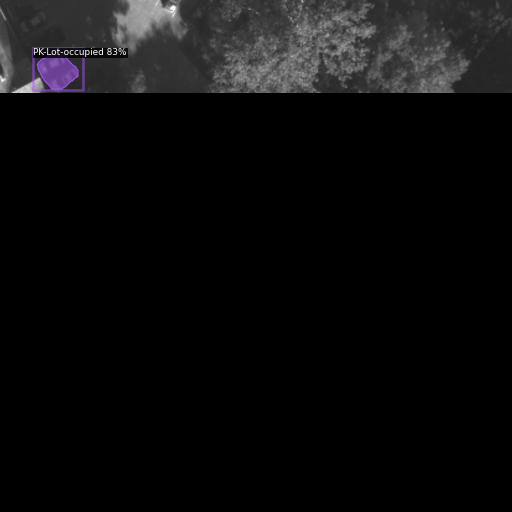

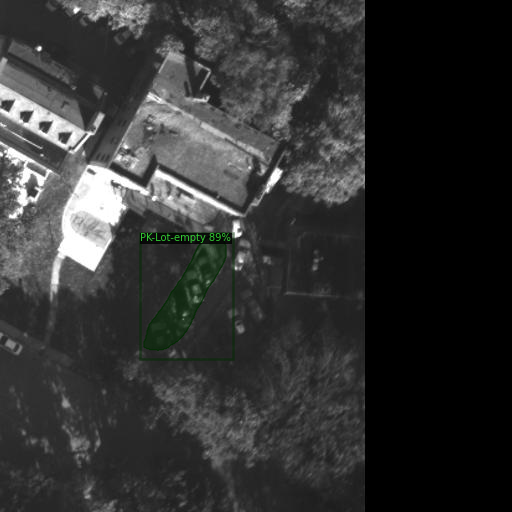

...

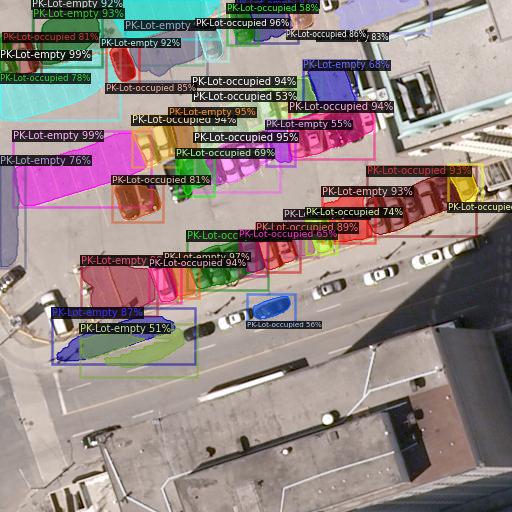

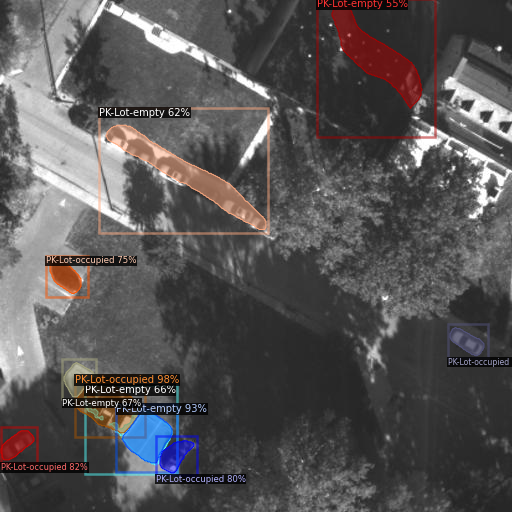

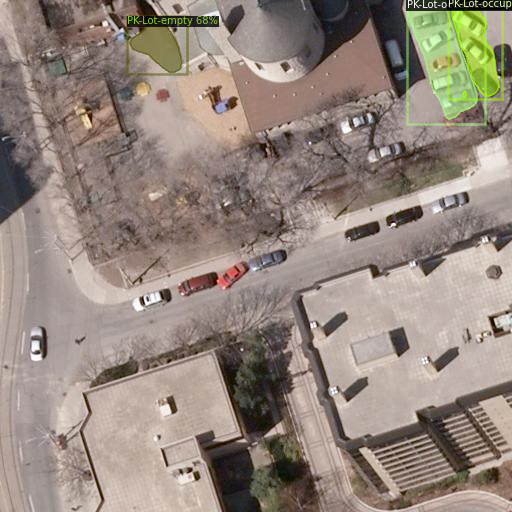

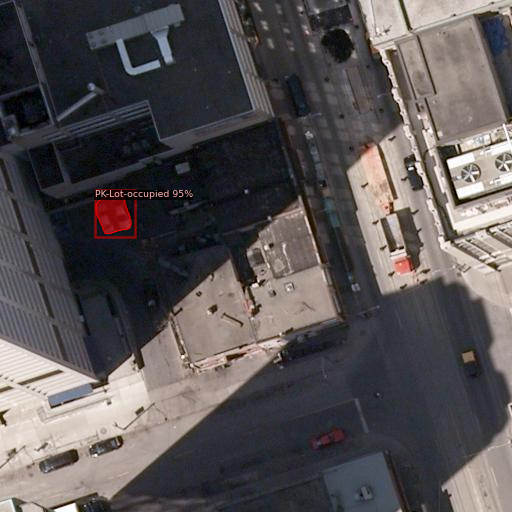

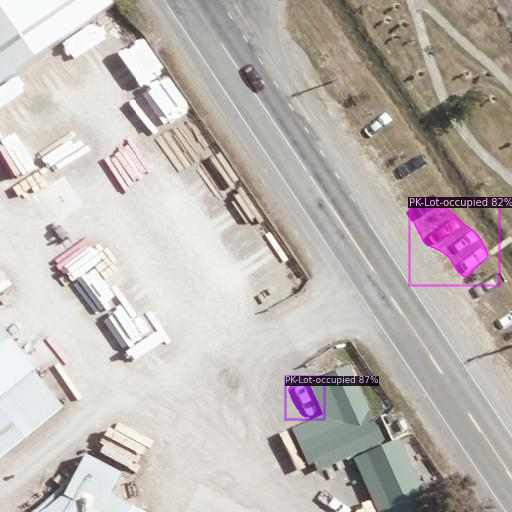

In [13]:

from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("my_dataset_test")
for d in random.sample(dataset_dicts, 20):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=test_metadata, 
                   scale=1, 
                   #instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

In [38]:
# from detectron2.utils.visualizer import ColorMode
import glob
for imageName in glob.glob('/content/drive/MyDrive/Cowc for detectrone2 test/test/*.jpg'):
#for d in dataset_dicts:
  im = cv2.imread(imageName)
  print(imageName)
  outputs = predictor(im)
  break
  #print(outputnump)
  #print(outputs["panoptic_seg"])
  # f = open("/content/drive/MyDrive/Cowc for detectrone2 test/COWC_PKLot_Predictions.txt","a")
  # f.write(str(d["file_name"]) +"\n" + str(outputs["instances"])+"\n")
  # f.close()

/content/drive/MyDrive/Cowc for detectrone2 test/test/03553.png_tile_109.jpg


In [27]:
masks = outputs['instances'].pred_masks.cpu().numpy()
categories = outputs['instances'].pred_classes.cpu().numpy()

In [24]:
for i, name in enumerate(MetadataCatalog.get(cfg.DATASETS.TRAIN[0]).thing_classes):
    print(i, name)

0 PK-Lot-empty
1 PK-Lot-occupied


In [28]:
import json
import numpy as np
from pycocotools import mask
from skimage import measure

In [26]:
outputs

{'instances': Instances(num_instances=29, image_height=512, image_width=512, fields=[pred_boxes: Boxes(tensor([[3.6249e+01, 4.2259e+02, 2.5380e+02, 5.0862e+02],
         [2.6754e+02, 3.8462e+02, 3.4649e+02, 4.4942e+02],
         [5.1167e+01, 3.7417e+02, 1.1727e+02, 4.2854e+02],
         [3.7802e+02, 2.6586e+02, 4.6823e+02, 3.2466e+02],
         [4.7017e-01, 1.4690e+02, 3.1824e+02, 3.0757e+02],
         [1.9647e+02, 4.7864e+02, 2.2550e+02, 5.1200e+02],
         [1.0458e+02, 3.7058e+02, 1.3478e+02, 4.1335e+02],
         [3.4290e+01, 3.9227e+02, 6.3440e+01, 4.3411e+02],
         [1.1913e+02, 3.1629e+02, 2.8890e+02, 4.0302e+02],
         [1.0687e+02, 4.8322e+02, 2.0719e+02, 5.1111e+02],
         [3.2070e+01, 2.7645e+02, 2.6549e+02, 3.9573e+02],
         [3.0475e+02, 1.6513e+02, 3.3462e+02, 2.0454e+02],
         [3.5314e+02, 3.7778e+02, 3.9348e+02, 4.3004e+02],
         [3.3759e+02, 3.8721e+02, 3.6887e+02, 4.3085e+02],
         [2.4494e+02, 4.5223e+02, 2.9708e+02, 5.0914e+02],
         [3.7

In [29]:
masks.shape[0]

29

In [40]:
import base64
encoded = base64.b64encode(open(imageName, "rb").read())
print(encoded)

b'/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBwcJCQgKDBQNDAsLDBkSEw8UHRofHh0aHBwgJC4nICIsIxwcKDcpLDAxNDQ0Hyc5PTgyPC4zNDL/2wBDAQkJCQwLDBgNDRgyIRwhMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjL/wAARCAIAAgADASIAAhEBAxEB/8QAHwAAAQUBAQEBAQEAAAAAAAAAAAECAwQFBgcICQoL/8QAtRAAAgEDAwIEAwUFBAQAAAF9AQIDAAQRBRIhMUEGE1FhByJxFDKBkaEII0KxwRVS0fAkM2JyggkKFhcYGRolJicoKSo0NTY3ODk6Q0RFRkdISUpTVFVWV1hZWmNkZWZnaGlqc3R1dnd4eXqDhIWGh4iJipKTlJWWl5iZmqKjpKWmp6ipqrKztLW2t7i5usLDxMXGx8jJytLT1NXW19jZ2uHi4+Tl5ufo6erx8vP09fb3+Pn6/8QAHwEAAwEBAQEBAQEBAQAAAAAAAAECAwQFBgcICQoL/8QAtREAAgECBAQDBAcFBAQAAQJ3AAECAxEEBSExBhJBUQdhcRMiMoEIFEKRobHBCSMzUvAVYnLRChYkNOEl8RcYGRomJygpKjU2Nzg5OkNERUZHSElKU1RVVldYWVpjZGVmZ2hpanN0dXZ3eHl6goOEhYaHiImKkpOUlZaXmJmaoqOkpaanqKmqsrO0tba3uLm6wsPExcbHyMnK0tPU1dbX2Nna4uPk5ebn6Onq8vP09fb3+Pn6/9oADAMBAAIRAxEAPwDLKBlNV5IQy+pFXniAPHeoSrAkHkVJoZU1jE5B24HtVV7ORMiNu351sMvykEVEUGARQBjESxg742PbJp3nHGC2B6CtYRgkg8g+tQvZxNkFcH1FAIq21zJav5lq7wv/AH1Yg11Gl/EPW7DCzXC3yD+GRcH865aSwYcq272NQM

In [88]:
number_of_masks = masks.shape[0]
for x in range(0, number_of_masks):
  #print(x)
  ground_truth_binary_mask = masks[x,:,:]
  #print(ground_truth_binary_mask)
  category = categories[x]
  if category == 0:
    cat = "PK-Lot-empty"
  else:
    cat == "PK-Lot-occupied"
  fortran_ground_truth_binary_mask = np.asfortranarray(ground_truth_binary_mask)
  # encoded_ground_truth = mask.encode(fortran_ground_truth_binary_mask)
  # ground_truth_area = mask.area(encoded_ground_truth)
  # ground_truth_bounding_box = mask.toBbox(encoded_ground_truth)
  contours = measure.find_contours(ground_truth_binary_mask, 0.5)

  annotation = {
        "shapes" : [],
        "label" : cat,
        "points": [],
        "group_id": None,
        "shape_type": "polygon",
        "flags": {},
    }
  for contour in contours:
    contour = np.flip(contour, axis=1)
    #segmentation = contour.ravel().tolist()
    segmentation = contour.reshape((len(contour.ravel())//2),2).tolist()
    annotation["points"].append(segmentation)
    
  print(json.dumps(annotation, indent=4,  separators=(',', ':',)))

{
    "shapes":[],
    "label":"PK-Lot-empty",
    "points":[
        [
            [
                74.0,
                508.5
            ],
            [
                73.0,
                508.5
            ],
            [
                72.0,
                508.5
            ],
            [
                71.0,
                508.5
            ],
            [
                70.0,
                508.5
            ],
            [
                69.0,
                508.5
            ],
            [
                68.5,
                508.0
            ],
            [
                68.0,
                507.5
            ],
            [
                67.0,
                507.5
            ],
            [
                66.0,
                507.5
            ],
            [
                65.0,
                507.5
            ],
            [
                64.0,
                507.5
            ],
            [
                63.0,
                

In [19]:
# type(outputs)

In [20]:
# try:
#     import cPickle as pickle
# except ImportError:  # Python 3.x
#     import pickle

# with open('data_pp.p', 'wb') as fp:
#     pickle.dump(outputs, fp, protocol=pickle.HIGHEST_PROTOCOL)


In [21]:
# with open('data_pp.p', 'rb') as fp:
#     data_pp = pickle.load(fp)

In [22]:
# type(data_pp['instances'])

In [23]:
# data_pp